<a href="https://colab.research.google.com/github/shabhash497/OpenCV/blob/main/MobileNet_Transfer_Learning_objectDetection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# step-1 : Load The Images
- we can load the images in 3 ways
- using opencv
  - when we apply opencv cv2.imread it will load as **pixels**
  - Again we need to **show** separately
- using pillow
  - when we apply pillow Image.open , it will load as directly image
- using keras
  - when we apply keras preprocess load image, directly load as image only

**Using OpenCV**

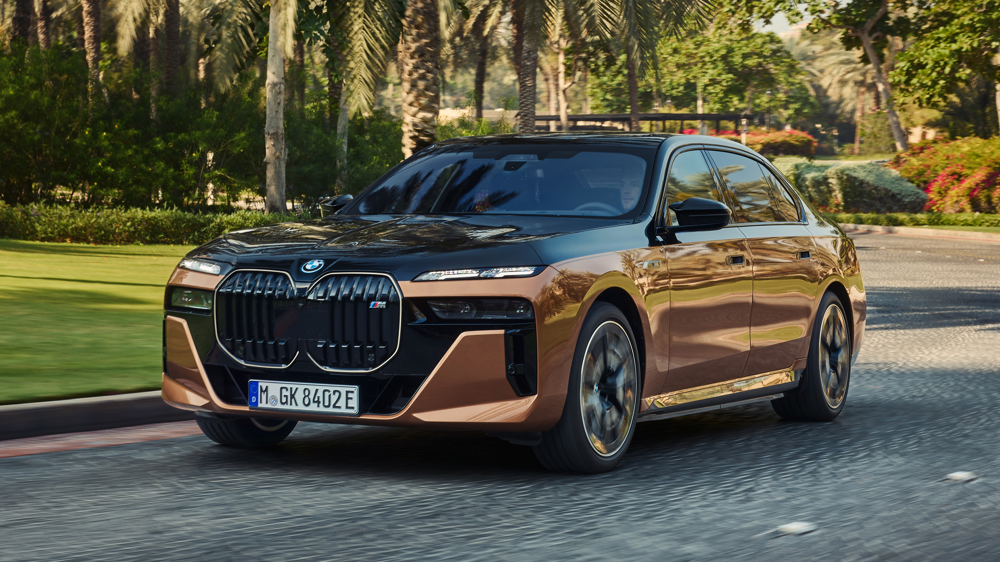

In [1]:
from google.colab.patches import cv2_imshow
import cv2
image = cv2.imread('/content/Benz.jpg') #Direct as pixel
cv2_imshow(image)

**Using Pillow**

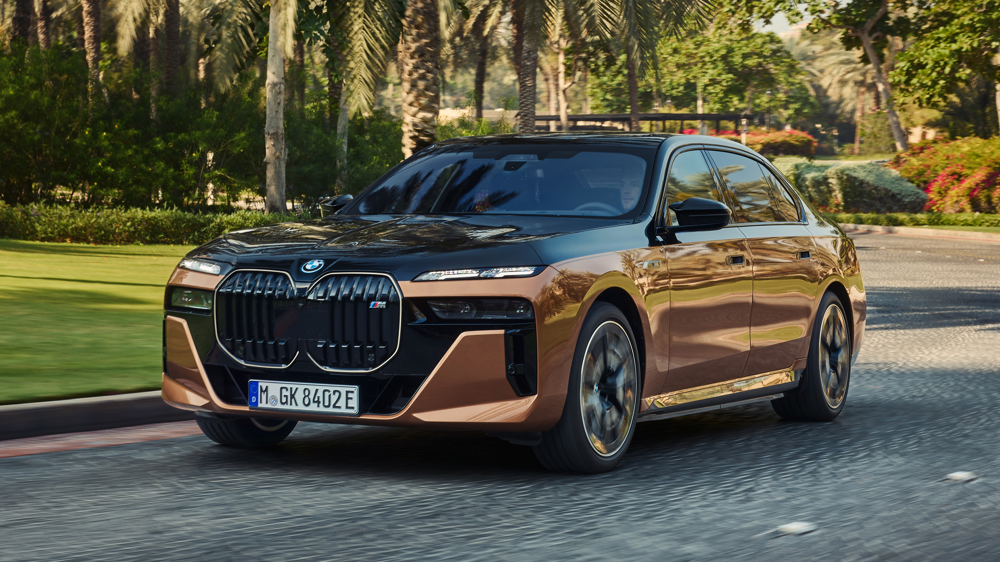

In [3]:
from PIL import Image
image = Image.open('/content/Benz.jpg') #Direct as image
image

**If you want to show axis level us matplotlib**

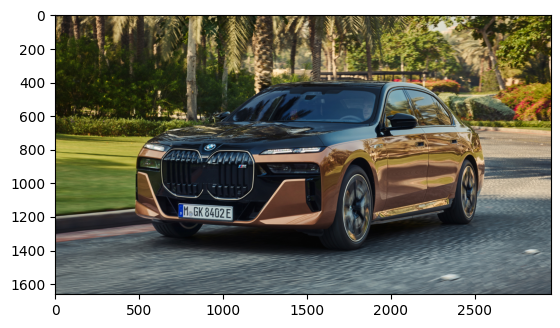

In [4]:
import matplotlib.pyplot as plt
plt.imshow(image)

**Using Keras**

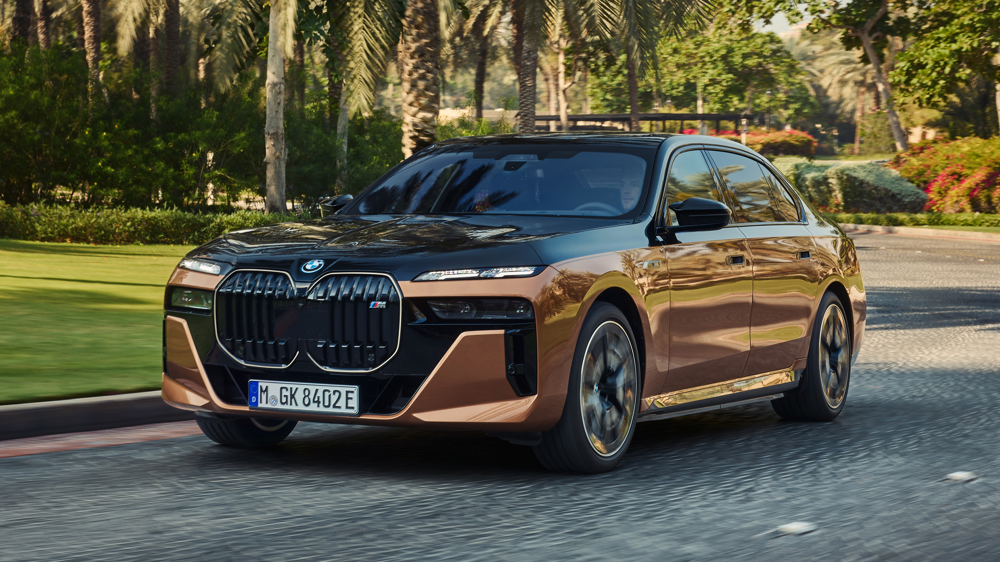

In [5]:
from keras.preprocessing.image import load_img
image = load_img('/content/Benz.jpg') #Direct as image
image
#

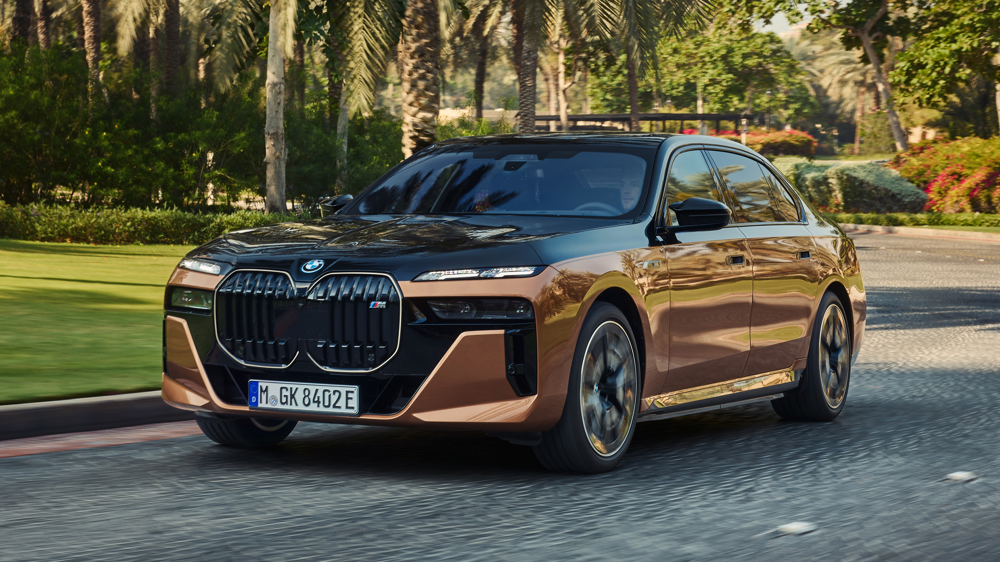

In [6]:
from IPython.display import Image
Image('/content/Benz.jpg')
#

- step1 : load the image
  - Mobilenet input shape of image 224,224
  - so load the image with target size of 22,224
- step2 : read the mobilenet model
- Step3 : read the class Names
- step4: understand mobilent model input shape
  - Is it included 4 dimensions like(bs,h,w,c)
  - Is it included 3 dimensions like(bs,h,w)
- step5:
  - If mobilenet Expects 4 dim make it as 4
  - If mobilenet Expects 3 dim make it as 3
- step6:pass the image to the MobileNet
- step7: Mobilenet trained with 1000 different classes
  - so for each image MobilNet gives 1000 probabilities
  - get the np.argmax will give probability Index
  - using that index check in classed index+1
  - Actually the classes load as 1001
   

**Step-1 : Load Image**

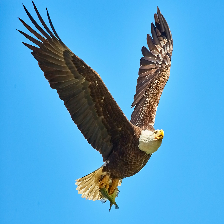

In [22]:
import tensorflow as tf
from keras.preprocessing import image
import numpy as np
import keras

# Mobile net input shape is (224,224)
img = image.load_img('/content/eagle.jpg',target_size=(224,224))
img

step-2 : read mobilenet model

In [23]:
mobile = keras.applications.mobilenet.MobileNet()

step-3 : Read the classes

In [24]:
class_names_path = tf.keras.utils.get_file('ImageNetLabels.txt','https://storage.googleapis.com/download.tensorflow.org/data/ImageNetLabels.txt')

with open(class_names_path,'r') as f:
  class_names = f.read().splitlines()

print('Class_name',class_names)

Class_name ['background', 'tench', 'goldfish', 'great white shark', 'tiger shark', 'hammerhead', 'electric ray', 'stingray', 'cock', 'hen', 'ostrich', 'brambling', 'goldfinch', 'house finch', 'junco', 'indigo bunting', 'robin', 'bulbul', 'jay', 'magpie', 'chickadee', 'water ouzel', 'kite', 'bald eagle', 'vulture', 'great grey owl', 'European fire salamander', 'common newt', 'eft', 'spotted salamander', 'axolotl', 'bullfrog', 'tree frog', 'tailed frog', 'loggerhead', 'leatherback turtle', 'mud turtle', 'terrapin', 'box turtle', 'banded gecko', 'common iguana', 'American chameleon', 'whiptail', 'agama', 'frilled lizard', 'alligator lizard', 'Gila monster', 'green lizard', 'African chameleon', 'Komodo dragon', 'African crocodile', 'American alligator', 'triceratops', 'thunder snake', 'ringneck snake', 'hognose snake', 'green snake', 'king snake', 'garter snake', 'water snake', 'vine snake', 'night snake', 'boa constrictor', 'rock python', 'Indian cobra', 'green mamba', 'sea snake', 'horne

In [25]:
img_array = image.img_to_array(img)
img_array.shape

(224, 224, 3)

Step-4 : Check the shape and convert according to that

In [26]:
mobile.input_shape

(None, 224, 224, 3)

In [27]:
image_array_expanded_dims = np.expand_dims(img_array,axis=0)
image_array_expanded_dims.shape

(1, 224, 224, 3)

Step-5 : Pass Image to MobileNet

In [28]:
preprocess_img = keras.applications.mobilenet.preprocess_input(image_array_expanded_dims)
preprocess_img.shape

(1, 224, 224, 3)

**Step-6 : Predictions**

In [29]:
predictions = mobile.predict(preprocess_img)
predictions.shape

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 691ms/step


(1, 1000)

In [30]:
len(class_names)

1001

In [31]:
np.argmax(predictions)

np.int64(22)

In [32]:
class_names[np.argmax(predictions)+1]

'bald eagle'

**Decode Predictions**
  - Pass the classes prbability array into the keras
  - It will give top 5 predictions
  

In [33]:
from keras.applications import imagenet_utils
decoded_predictions = imagenet_utils.decode_predictions(predictions)
decoded_predictions

[[('n01614925', 'bald_eagle', np.float32(0.95085657)),
  ('n01608432', 'kite', np.float32(0.04297525)),
  ('n01616318', 'vulture', np.float32(0.0059099905)),
  ('n02051845', 'pelican', np.float32(5.3265623e-05)),
  ('n01798484', 'prairie_chicken', np.float32(3.451988e-05))]]